In [ ]:
%pip install -r requirements.txt

In [2]:
from statsbombpy import sb
import mplsoccer as mpl
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')


In [3]:
matches = sb.matches(competition_id=43, season_id=106)

In [15]:
french_2022 = matches[(matches['home_team'] == 'France') |( matches['away_team'] == 'France')]
french_2022
# Create an empty dictionary
country_to_match_id = {}

# Iterate over each row in the DataFrame
for index, row in french_2022.iterrows():
    # Check if the match involves France
    if 'France' in row['home_team']:
        # Get the other team involved in the match
        other_team = row['away_team']
        # Add the other team and match_id to the dictionary
        country_to_match_id[other_team] = row['match_id']
    else:
        country_to_match_id[row['home_team']] = row['match_id']

print(country_to_match_id)


{'Argentina': 3869685, 'Denmark': 3857266, 'England': 3869354, 'Morocco': 3869552, 'Poland': 3869152, 'Australia': 3857279, 'Tunisia': 3857275}


In [11]:
events = sb.events(match_id = '3869486')
events.columns

Index(['ball_receipt_outcome', 'ball_recovery_recovery_failure',
       'block_deflection', 'carry_end_location', 'clearance_aerial_won',
       'clearance_body_part', 'clearance_head', 'clearance_left_foot',
       'clearance_other', 'clearance_right_foot', 'counterpress',
       'dribble_nutmeg', 'dribble_outcome', 'dribble_overrun', 'duel_outcome',
       'duel_type', 'duration', 'foul_committed_advantage',
       'foul_committed_card', 'foul_committed_offensive',
       'foul_committed_type', 'foul_won_advantage', 'foul_won_defensive',
       'goalkeeper_body_part', 'goalkeeper_end_location', 'goalkeeper_outcome',
       'goalkeeper_position', 'goalkeeper_punched_out', 'goalkeeper_technique',
       'goalkeeper_type', 'id', 'index', 'injury_stoppage_in_chain',
       'interception_outcome', 'location', 'match_id', 'minute',
       'miscontrol_aerial_won', 'off_camera', 'out', 'pass_aerial_won',
       'pass_angle', 'pass_assisted_shot_id', 'pass_body_part', 'pass_cross',
       'pa

In [26]:
def visualize_heatmap(df, team):
    events = df[~pd.isna(df['location']) & 
                    (df['team'] == "France")]
    x, y = np.array(events['location'].tolist()).T
    pitch = mpl.Pitch(line_alpha=0.5, goal_type='box',goal_alpha=0.3,pitch_color='grass', line_color='white', stripe=True)
    fig, ax = pitch.grid(grid_height=0.9, title_height=0.06, axis=False,
                         endnote_height=0.04, title_space=0, endnote_space=0)
    pitch.kdeplot(x, y, cmap='Oranges', fill=True, levels=10, alpha=0.8, ax=ax['pitch'])
    fig.suptitle("France's Heatmap against "+team, fontsize = 20)

In [27]:
def shot_visualizer(events,team):
    shots = events[(events['type'] == "Shot") & 
                (events['team'] == "France") &
                (events['shot_type'] != "Penalty")]
    coordinates = shots[['location', 'shot_end_location']]
    x1, y1 = np.array(coordinates['location'].tolist()).T
    x2, y2 = np.array([t[0:2] for t in  coordinates['shot_end_location'].tolist()]).T
    shots['x1'], shots['y1'] = x1,y1
    xg = np.array(shots['shot_statsbomb_xg'].tolist())
    goal = ['blue' if g == "Goal" else 'red' for g in shots['shot_outcome'].to_list()]
    pitch = mpl.Pitch(line_alpha=0.5,goal_type='box',goal_alpha=0.3,pitch_color='grass', line_color='white', stripe=True)
    fig, ax = pitch.grid(grid_height=0.9, title_height=0.06, axis=False, endnote_height=0.04, title_space=0, endnote_space=0)
    pitch.scatter(x1, y1, s=xg*500,  color=goal, linewidth=1, alpha=1, ax=ax["pitch"], zorder = 3)
    for i, row in shots.iterrows():
        pitch.annotate(round(row.shot_statsbomb_xg,2), xy=(row.x1, row.y1), c='black', va='center', ha='center', size=12, ax=ax["pitch"], zorder = 4)
        pitch.arrows(x1, y1, x2, y2, alpha=0.4, color=goal,
                    headaxislength=3, headlength=3, headwidth=4, width=2, ax=ax["pitch"])
    fig.suptitle("France's Shots against "+team, fontsize = 20)

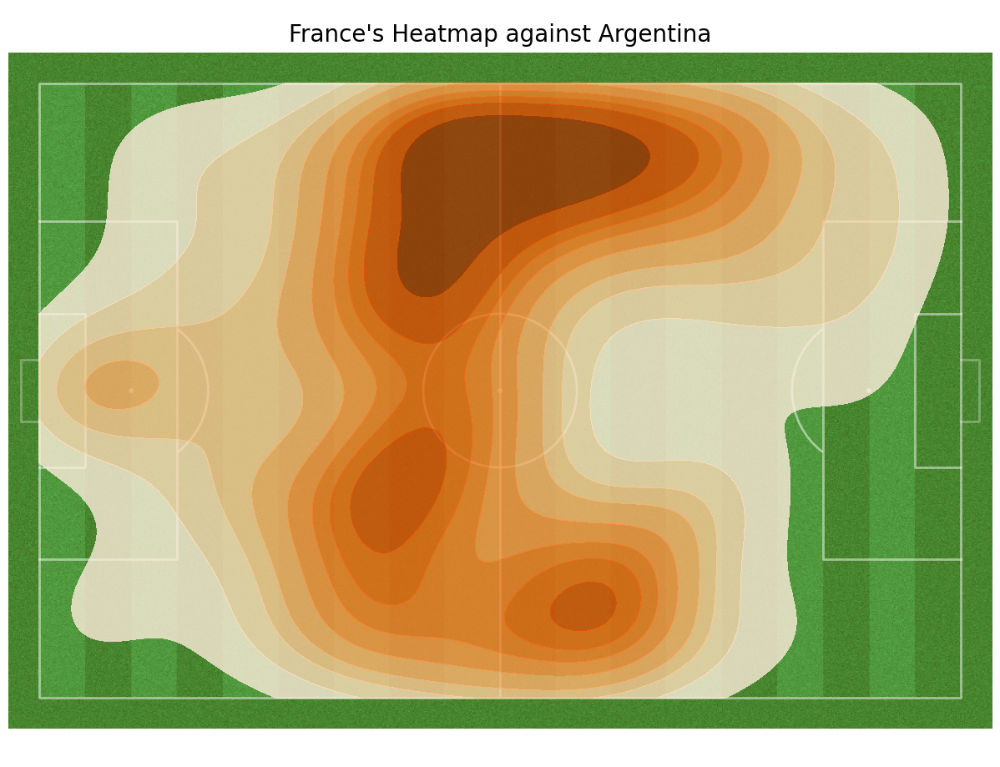

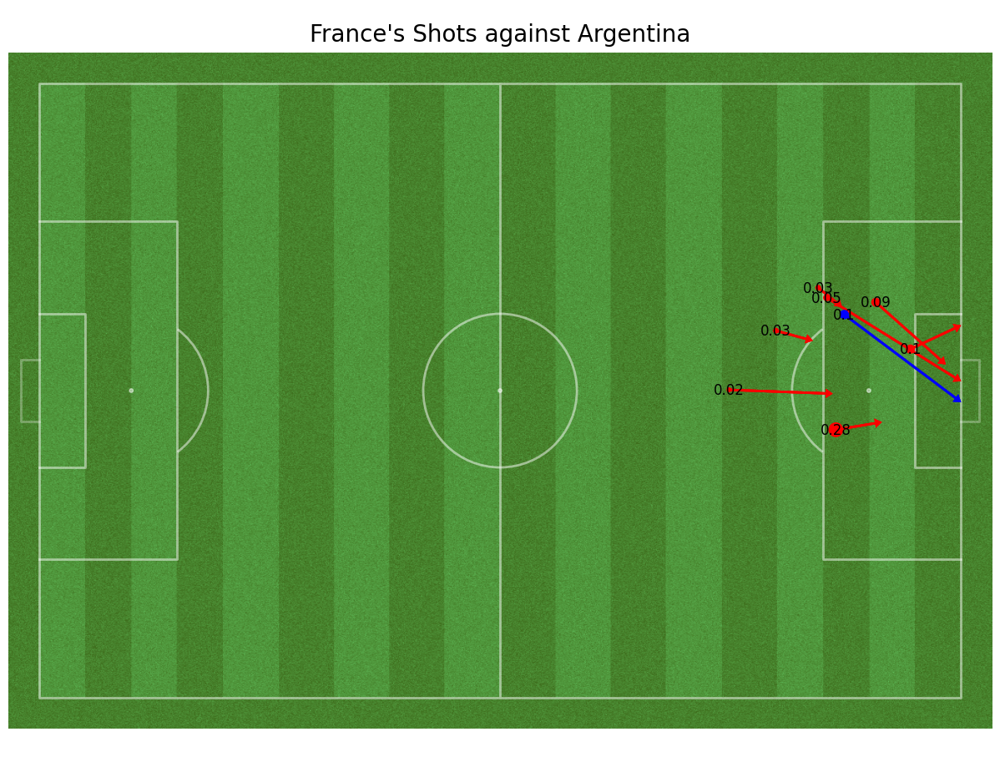

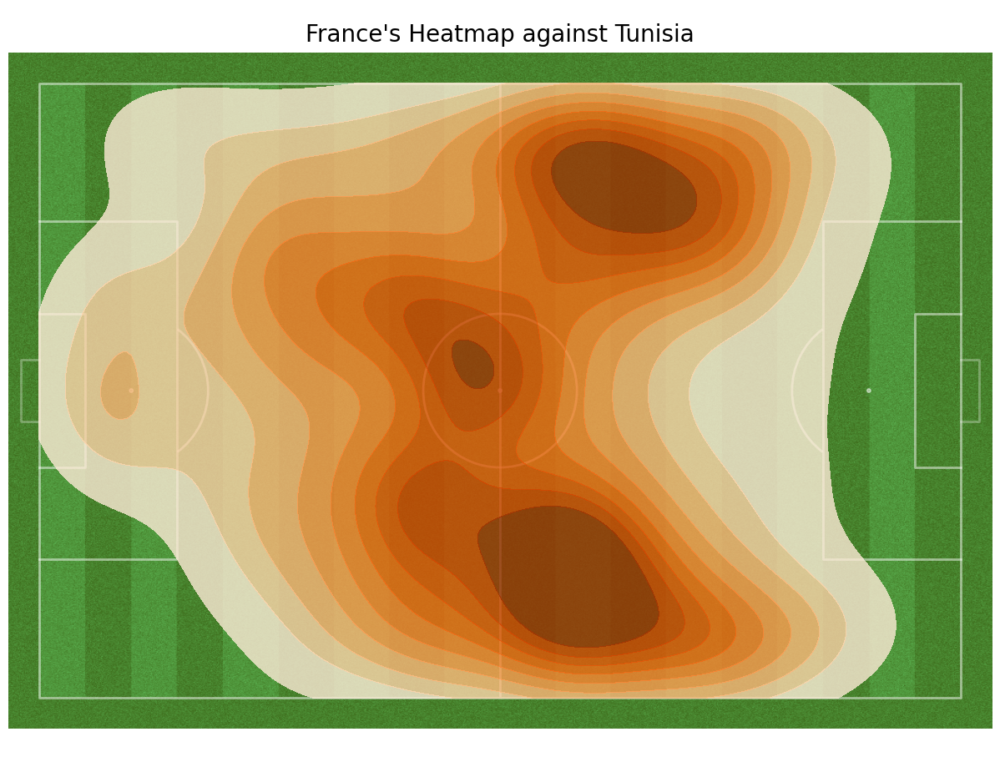

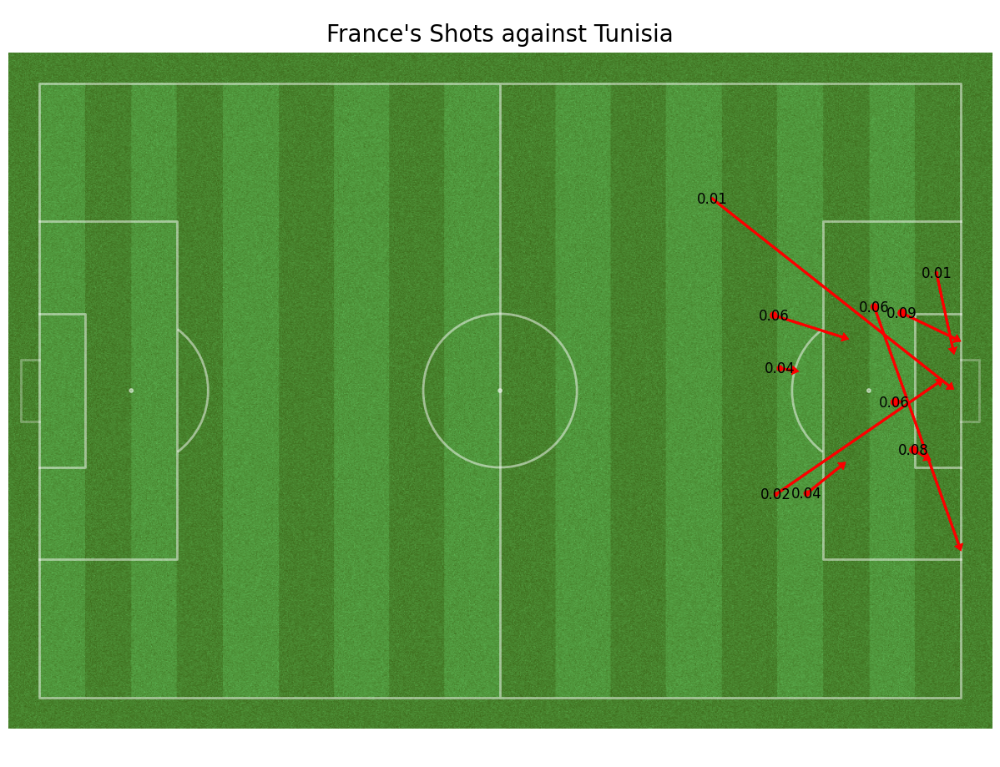

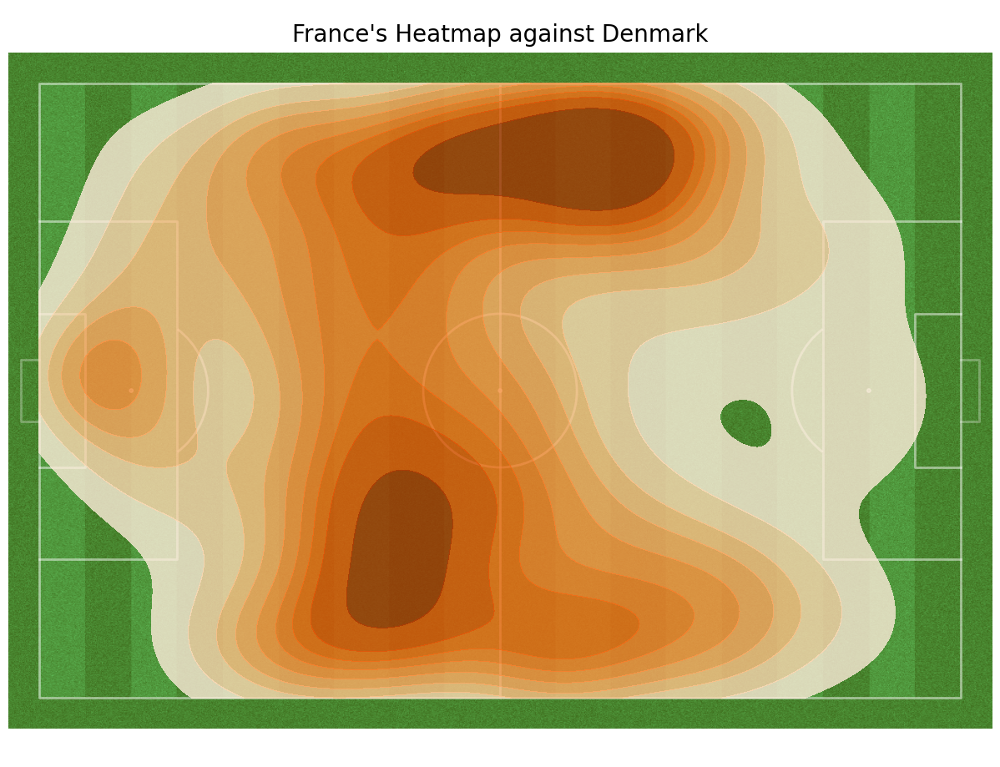

...

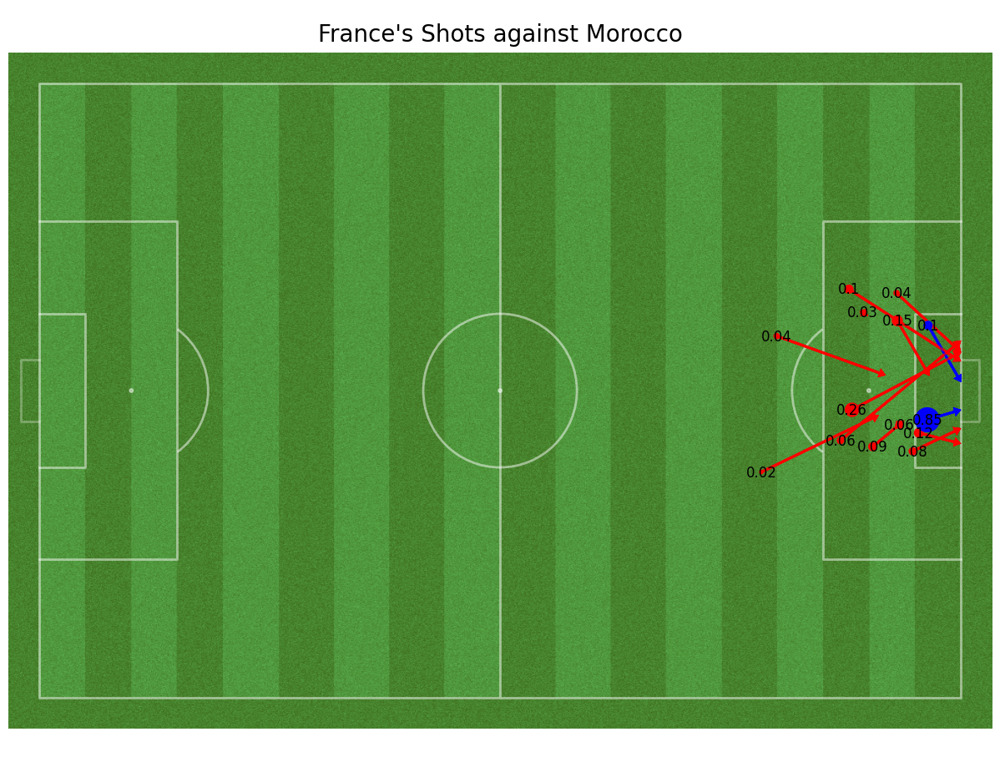

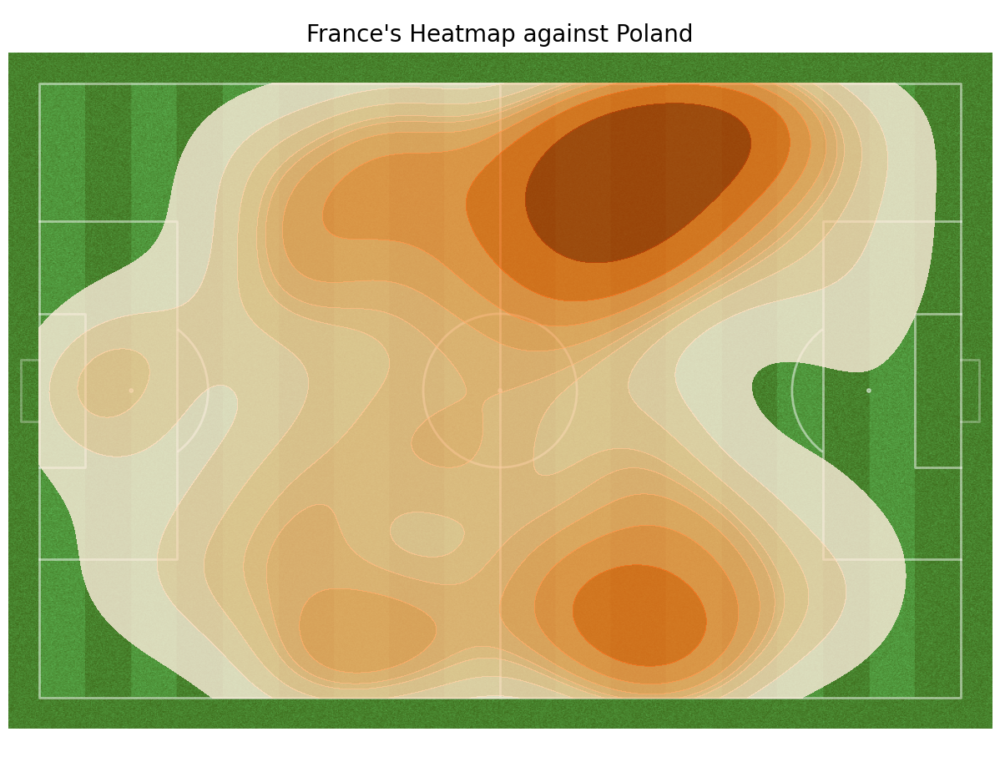

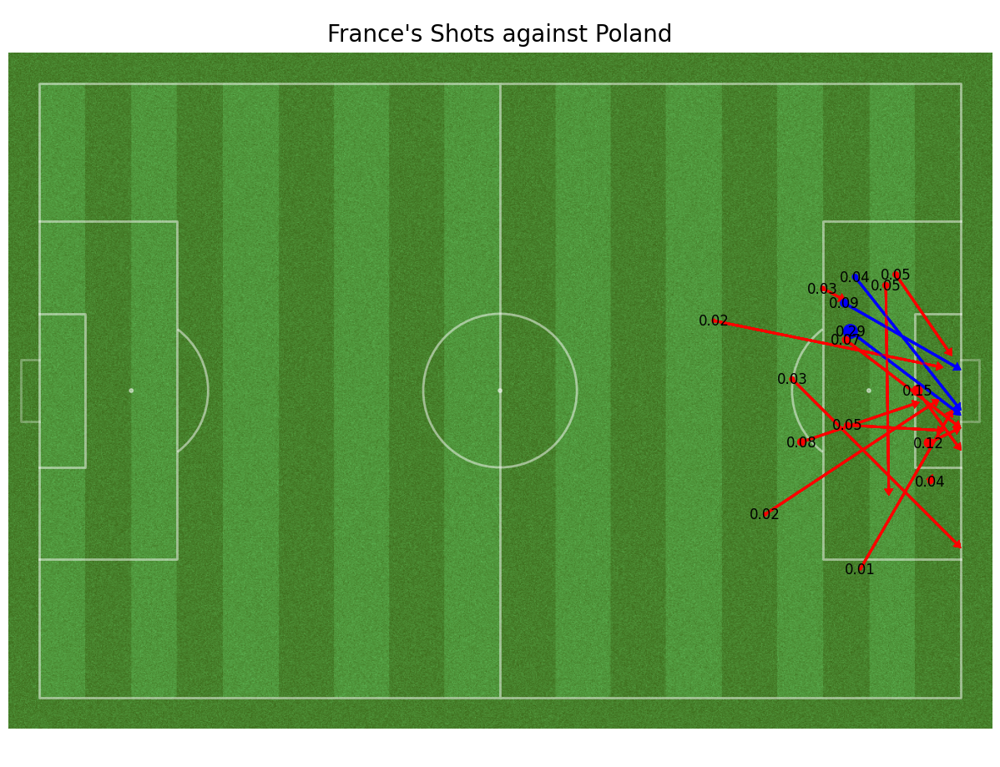

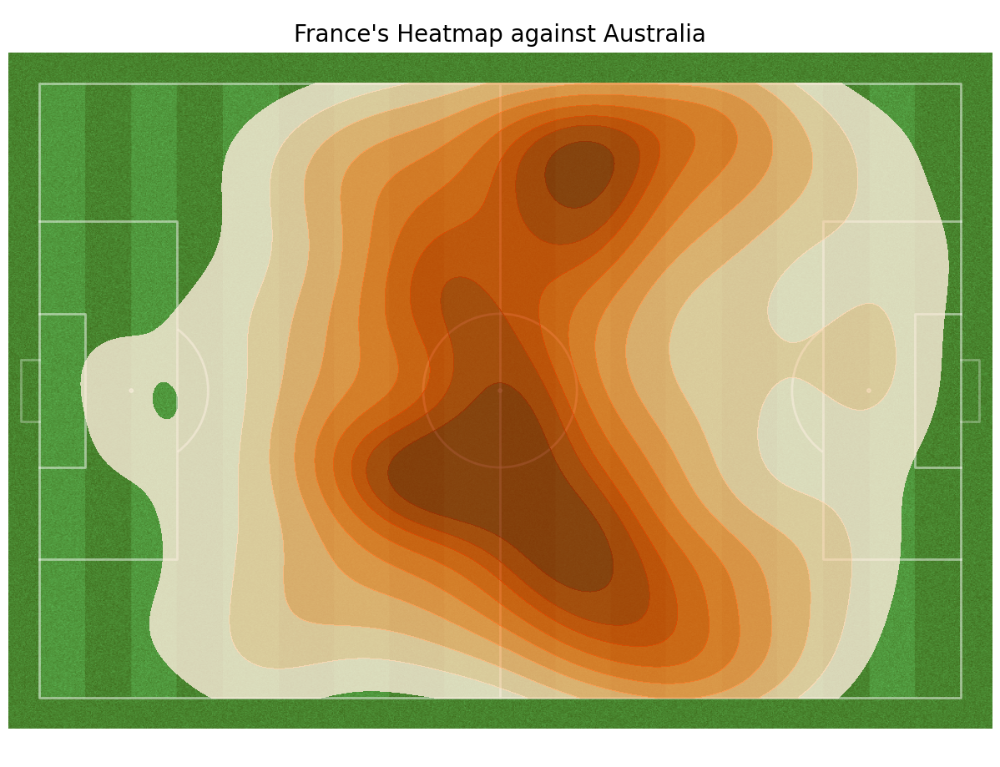

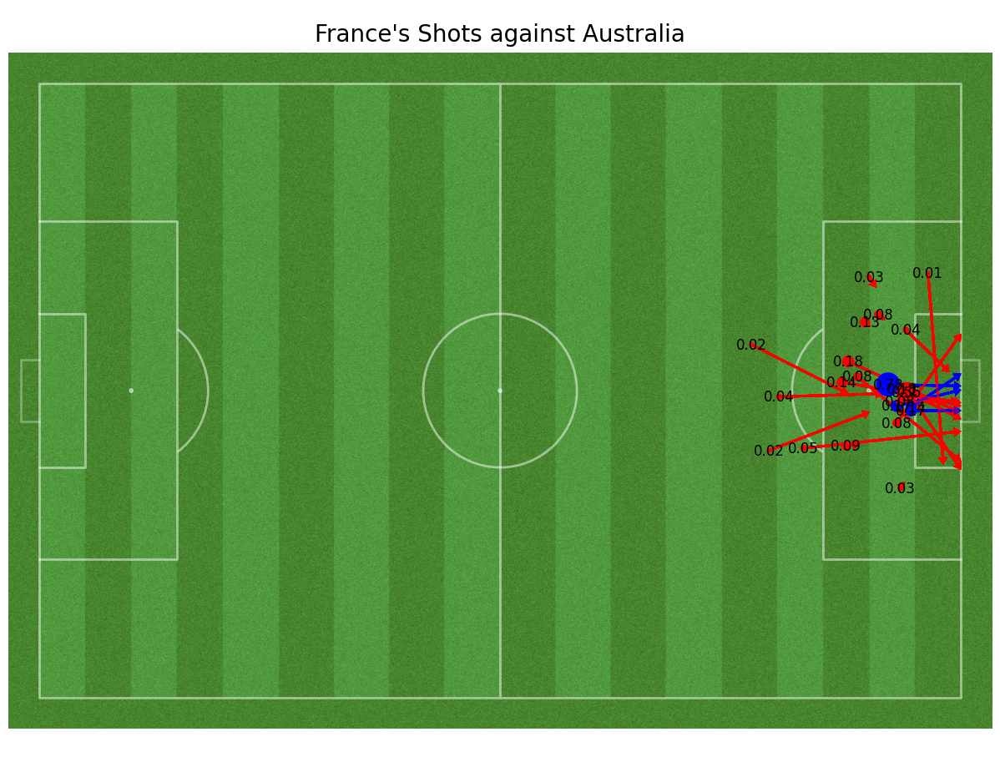

In [28]:
selected_teams = ['Argentina', 'Tunisia', 'Denmark', 'England', 'Morocco', 'Poland', 'Australia'] # replace with your actual team names
selected_modes = ['activity', 'shotmap']
for selected_team in selected_teams:
    for selected_mode in selected_modes:
        if(selected_mode == 'activity'):
            events = sb.events(match_id = country_to_match_id[selected_team])
            visualize_heatmap(events, selected_team)
        else:
            events = sb.events(match_id = country_to_match_id[selected_team])
            shot_visualizer(events, selected_team)
        imageName = f"{selected_team}_{selected_mode}"
        imagePath = f"data/{imageName}.png"
        plt.savefig(imagePath)
